# BUSN 41204: Machine Learning - Winter 2023
# Final Project: Trading and Finding Arbitrages in Bitcoin Markets
# Group: Riya Sheth, Anvita Panandikar, Mani Sawhney

## Imports

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import scipy as sp
import quandl
from boruta import BorutaPy
import functools
import seaborn as sns
import statistics
from sklearn.linear_model import Lasso
import statsmodels.api as sm
quandl.ApiConfig.api_key= "dSEK8-iUMxdiDUyrcPdc"
import warnings
from datetime import timedelta
from sklearn import preprocessing
from datetime import datetime
import random
from sklearn.model_selection import *
import statsmodels.regression.linear_model as linreg
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.ensemble import BaggingRegressor
import xgboost as xgb
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import confusion_matrix
from scikitplot.metrics import plot_lift_curve
import pandas as pd
from scipy.stats import ttest_ind
from itertools import product
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from tqdm.notebook import tqdm, trange
import functools
warnings.filterwarnings('ignore')
np.random.seed(2)
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.preprocessing import LabelEncoder
from varname import nameof
from sklearn.ensemble import RandomForestRegressor
import quandl
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.neighbors import KNeighborsRegressor
from scipy.stats import uniform as sp_randFloat
from scipy.stats import randint as sp_randInt
from sklearn.linear_model import Ridge, Lasso, LinearRegression
import statsmodels.api as sm
from sklearn.feature_selection import SequentialFeatureSelector
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px
from sklearn.feature_selection import RFECV
from sklearn.metrics import make_scorer 
from statsmodels.graphics.gofplots import qqplot
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
sns.set_theme()
import shap
import xgboost
from pmdarima import auto_arima
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

## 1. Data Collection

### Quandl Bitcoin Data

In [2]:
start_date = pd.Timestamp('2018-01-01')
end_date = pd.Timestamp('2023-01-01')

In [3]:
btc_additional_hash = quandl.get('BCHAIN/HRATE', start_date=start_date, end_date=end_date)
btc_additional_hash.columns = ['hash rate']
btc_additional_hash.head()

,hash rate
Date,
2018-01-01,1.497558e+07
2018-01-02,1.641554e+07
2018-01-03,1.507158e+07
2018-01-04,1.612755e+07
2018-01-05,1.372762e+07


In [4]:
btc_additional_average_block_size = quandl.get('BCHAIN/AVBLS', start_date=start_date, end_date=end_date)
btc_additional_average_block_size.columns = ['average block size']
btc_additional_average_block_size.head()

,average block size
Date,
2018-01-01,1.043383
2018-01-02,1.041368
2018-01-03,1.065513
2018-01-04,1.065833
2018-01-05,1.067636


### Sentiment Data

In [5]:
btc_sentiment_analysis = pd.read_csv('augmento_btc.csv')
btc_sentiment_analysis = btc_sentiment_analysis.loc[btc_sentiment_analysis['date']>='2018-01-01']
btc_sentiment_analysis = btc_sentiment_analysis.loc[btc_sentiment_analysis['date']<'2023-01-01']
columns_sentiment_analysis = ['date', 'bitcointalk_negative', 'twitter_regulation_politics', 'reddit_advice_support']
btc_sentiment_analysis =  btc_sentiment_analysis.loc[:, columns_sentiment_analysis].set_index('date')
btc_sentiment_analysis.index = pd.to_datetime(btc_sentiment_analysis.index)
btc_sentiment_analysis.head()

,bitcointalk_negative,twitter_regulation_politics,reddit_advice_support
date,,,
2018-01-01 00:00:00,28.0,2.0,50.0
2018-01-01 01:00:00,45.0,1.0,56.0
2018-01-01 02:00:00,34.0,2.0,50.0
2018-01-01 03:00:00,46.0,2.0,44.0
2018-01-01 04:00:00,55.0,3.0,41.0


### Exchange Data Collection and Merging

In [6]:
@functools.lru_cache(maxsize=16)
def get_data(name):
    try:
        df = pd.read_csv(name+'_orig.csv', usecols=['date', 'timestamp', 'price', 'volume'])
        df['date'] = pd.to_datetime(df['date'])
        df = df.set_index('date')
    except:
        df = pd.read_csv(name+'.csv.gz', delimiter=',', compression='gzip', header=None)
        start_date = pd.Timestamp('2018-01-01')
        end_date = pd.Timestamp('2023-01-01')
        column_names = ['timestamp', 'price', 'volume']
        df.columns = column_names
        df['date'] = df['timestamp'].apply(lambda x: datetime.fromtimestamp(x))
        df = df.loc[(df['date']>=start_date) & (df['date']<end_date)].set_index('date')
        df = df.resample('H').last().ffill()
        start_date = pd.Timestamp('2018-01-01 04:00:00')
        end_date = pd.Timestamp('2022-12-31 21:00:00')
        df = df.loc[(df.index>=start_date) & (df.index<=end_date)]
      
    df['bitcointalk_negative'] = btc_sentiment_analysis['bitcointalk_negative']
    df['twitter_regulation_politics'] = btc_sentiment_analysis['twitter_regulation_politics']
    df['reddit_advice_support'] = btc_sentiment_analysis['reddit_advice_support']
    
    dt = pd.to_datetime(df.index.date)
    df = df.reset_index().set_index(dt)
    df['hash rate'] = btc_additional_hash['hash rate']
    df['average block size'] = btc_additional_average_block_size['average block size']
    
    df = df.reset_index(drop=True)
    df = df.ffill()
    
    return df

### USA

In [7]:
bitstampUSD_orig = get_data('bitstampUSD')
bitstampUSD_orig

,date,timestamp,price,volume,bitcointalk_negative,twitter_regulation_politics,reddit_advice_support,hash rate,average block size
0,2018-01-01 04:00:00,1.514804e+09,13548.46,0.794814,55.0,3.0,41.0,1.497558e+07,1.043383
1,2018-01-01 05:00:00,1.514808e+09,13303.35,0.100000,57.0,5.0,25.0,1.497558e+07,1.043383
2,2018-01-01 06:00:00,1.514812e+09,13250.35,1.062718,36.0,1.0,42.0,1.497558e+07,1.043383
3,2018-01-01 07:00:00,1.514815e+09,13118.56,0.249186,47.0,1.0,22.0,1.497558e+07,1.043383
4,2018-01-01 08:00:00,1.514819e+09,13229.56,1.300000,49.0,1.0,29.0,1.497558e+07,1.043383
...,...,...,...,...,...,...,...,...,...
43813,2022-12-31 17:00:00,1.672531e+09,16528.00,0.008970,13.0,2.0,32.0,2.742413e+08,1.071711
43814,2022-12-31 18:00:00,1.672535e+09,16521.00,0.013780,13.0,2.0,32.0,2.742413e+08,1.071711
43815,2022-12-31 19:00:00,1.672538e+09,16542.00,0.001510,13.0,2.0,32.0,2.742413e+08,1.071711
43816,2022-12-31 20:00:00,1.672542e+09,16537.00,0.001700,13.0,2.0,32.0,2.742413e+08,1.071711


### Australia

In [8]:
btcmarketsAUD_orig = get_data('btcmarketsAUD')
btcmarketsAUD_orig

,date,timestamp,price,volume,bitcointalk_negative,twitter_regulation_politics,reddit_advice_support,hash rate,average block size
0,2018-01-01 04:00:00,1.514804e+09,18808.02,0.007314,55.0,3.0,41.0,1.497558e+07,1.043383
1,2018-01-01 05:00:00,1.514808e+09,18472.98,0.060000,57.0,5.0,25.0,1.497558e+07,1.043383
2,2018-01-01 06:00:00,1.514812e+09,18405.00,0.102513,36.0,1.0,42.0,1.497558e+07,1.043383
3,2018-01-01 07:00:00,1.514815e+09,18352.04,0.015906,47.0,1.0,22.0,1.497558e+07,1.043383
4,2018-01-01 08:00:00,1.514819e+09,18419.67,0.008918,49.0,1.0,29.0,1.497558e+07,1.043383
...,...,...,...,...,...,...,...,...,...
43813,2022-12-31 17:00:00,1.672531e+09,24372.46,0.000509,13.0,2.0,32.0,2.742413e+08,1.071711
43814,2022-12-31 18:00:00,1.672534e+09,24306.60,0.000566,13.0,2.0,32.0,2.742413e+08,1.071711
43815,2022-12-31 19:00:00,1.672538e+09,24343.40,0.041363,13.0,2.0,32.0,2.742413e+08,1.071711
43816,2022-12-31 20:00:00,1.672542e+09,24379.27,0.486314,13.0,2.0,32.0,2.742413e+08,1.071711


### Canada

In [9]:
krakenCAD_orig = get_data('krakenCAD')
krakenCAD_orig

,date,timestamp,price,volume,bitcointalk_negative,twitter_regulation_politics,reddit_advice_support,hash rate,average block size
0,2018-01-01 04:00:00,1.514799e+09,17091.7,0.010000,55.0,3.0,41.0,1.497558e+07,1.043383
1,2018-01-01 05:00:00,1.514808e+09,16974.7,0.003730,57.0,5.0,25.0,1.497558e+07,1.043383
2,2018-01-01 06:00:00,1.514810e+09,16850.0,0.578049,36.0,1.0,42.0,1.497558e+07,1.043383
3,2018-01-01 07:00:00,1.514815e+09,16850.0,0.780000,47.0,1.0,22.0,1.497558e+07,1.043383
4,2018-01-01 08:00:00,1.514819e+09,16844.1,0.022270,49.0,1.0,29.0,1.497558e+07,1.043383
...,...,...,...,...,...,...,...,...,...
43813,2022-12-31 17:00:00,1.672531e+09,22242.0,0.004751,13.0,2.0,32.0,2.742413e+08,1.071711
43814,2022-12-31 18:00:00,1.672534e+09,22225.9,0.021948,13.0,2.0,32.0,2.742413e+08,1.071711
43815,2022-12-31 19:00:00,1.672538e+09,22225.9,0.078985,13.0,2.0,32.0,2.742413e+08,1.071711
43816,2022-12-31 20:00:00,1.672542e+09,22224.6,0.018487,13.0,2.0,32.0,2.742413e+08,1.071711


### Europe

In [10]:
bcEUR_orig = get_data('bcEUR')
bcEUR_orig

,date,timestamp,price,volume,bitcointalk_negative,twitter_regulation_politics,reddit_advice_support,hash rate,average block size
0,2018-01-01 04:00:00,1.514803e+09,11789.99,0.004241,55.0,3.0,41.0,1.497558e+07,1.043383
1,2018-01-01 05:00:00,1.514806e+09,11784.67,0.008486,57.0,5.0,25.0,1.497558e+07,1.043383
2,2018-01-01 06:00:00,1.514810e+09,11684.94,0.041934,36.0,1.0,42.0,1.497558e+07,1.043383
3,2018-01-01 07:00:00,1.514812e+09,11684.70,0.094140,47.0,1.0,22.0,1.497558e+07,1.043383
4,2018-01-01 08:00:00,1.514819e+09,11384.98,0.010000,49.0,1.0,29.0,1.497558e+07,1.043383
...,...,...,...,...,...,...,...,...,...
43813,2022-12-31 17:00:00,1.672520e+09,15507.26,0.004514,13.0,2.0,32.0,2.742413e+08,1.071711
43814,2022-12-31 18:00:00,1.672520e+09,15507.26,0.004514,13.0,2.0,32.0,2.742413e+08,1.071711
43815,2022-12-31 19:00:00,1.672520e+09,15507.26,0.004514,13.0,2.0,32.0,2.742413e+08,1.071711
43816,2022-12-31 20:00:00,1.672541e+09,15419.92,0.000893,13.0,2.0,32.0,2.742413e+08,1.071711


### Israel

In [11]:
bit2cILS_orig = get_data('bit2cILS')
bit2cILS_orig

,date,timestamp,price,volume,bitcointalk_negative,twitter_regulation_politics,reddit_advice_support,hash rate,average block size
0,2018-01-01 04:00:00,1.514804e+09,53499.00,0.037384,55.0,3.0,41.0,1.497558e+07,1.043383
1,2018-01-01 05:00:00,1.514808e+09,52125.02,0.010606,57.0,5.0,25.0,1.497558e+07,1.043383
2,2018-01-01 06:00:00,1.514812e+09,52500.00,0.009524,36.0,1.0,42.0,1.497558e+07,1.043383
3,2018-01-01 07:00:00,1.514814e+09,52496.00,0.000098,47.0,1.0,22.0,1.497558e+07,1.043383
4,2018-01-01 08:00:00,1.514819e+09,52400.00,0.297230,49.0,1.0,29.0,1.497558e+07,1.043383
...,...,...,...,...,...,...,...,...,...
43813,2022-12-31 17:00:00,1.672531e+09,55028.00,0.008777,13.0,2.0,32.0,2.742413e+08,1.071711
43814,2022-12-31 18:00:00,1.672531e+09,55028.00,0.008777,13.0,2.0,32.0,2.742413e+08,1.071711
43815,2022-12-31 19:00:00,1.672531e+09,55028.00,0.008777,13.0,2.0,32.0,2.742413e+08,1.071711
43816,2022-12-31 20:00:00,1.672531e+09,55028.00,0.008777,13.0,2.0,32.0,2.742413e+08,1.071711


### Japan

In [12]:
btcboxJPY_orig = get_data('btcboxJPY')
btcboxJPY_orig

,date,timestamp,price,volume,bitcointalk_negative,twitter_regulation_politics,reddit_advice_support,hash rate,average block size
0,2018-01-01 04:00:00,1.514804e+09,1667005.0,0.0170,55.0,3.0,41.0,1.497558e+07,1.043383
1,2018-01-01 05:00:00,1.514808e+09,1645043.0,0.2900,57.0,5.0,25.0,1.497558e+07,1.043383
2,2018-01-01 06:00:00,1.514812e+09,1625208.0,0.4190,36.0,1.0,42.0,1.497558e+07,1.043383
3,2018-01-01 07:00:00,1.514815e+09,1594335.0,0.0990,47.0,1.0,22.0,1.497558e+07,1.043383
4,2018-01-01 08:00:00,1.514819e+09,1602632.0,1.0020,49.0,1.0,29.0,1.497558e+07,1.043383
...,...,...,...,...,...,...,...,...,...
43813,2022-12-31 17:00:00,1.672531e+09,2167074.0,0.0928,13.0,2.0,32.0,2.742413e+08,1.071711
43814,2022-12-31 18:00:00,1.672535e+09,2165129.0,0.0416,13.0,2.0,32.0,2.742413e+08,1.071711
43815,2022-12-31 19:00:00,1.672538e+09,2167572.0,0.0718,13.0,2.0,32.0,2.742413e+08,1.071711
43816,2022-12-31 20:00:00,1.672542e+09,2168399.0,0.0860,13.0,2.0,32.0,2.742413e+08,1.071711


### Korea

In [13]:
korbitKRW_orig = get_data('korbitKRW')
korbitKRW_orig

,date,timestamp,price,volume,bitcointalk_negative,twitter_regulation_politics,reddit_advice_support,hash rate,average block size
0,2018-01-01 04:00:00,1.514804e+09,19037000.0,0.055420,55.0,3.0,41.0,1.497558e+07,1.043383
1,2018-01-01 05:00:00,1.514808e+09,18851500.0,0.168200,57.0,5.0,25.0,1.497558e+07,1.043383
2,2018-01-01 06:00:00,1.514812e+09,18827000.0,0.100000,36.0,1.0,42.0,1.497558e+07,1.043383
3,2018-01-01 07:00:00,1.514815e+09,18565500.0,0.111495,47.0,1.0,22.0,1.497558e+07,1.043383
4,2018-01-01 08:00:00,1.514819e+09,18699500.0,3.449806,49.0,1.0,29.0,1.497558e+07,1.043383
...,...,...,...,...,...,...,...,...,...
43813,2022-12-31 17:00:00,1.672531e+09,21075000.0,0.000818,13.0,2.0,32.0,2.742413e+08,1.071711
43814,2022-12-31 18:00:00,1.672535e+09,21090000.0,0.014686,13.0,2.0,32.0,2.742413e+08,1.071711
43815,2022-12-31 19:00:00,1.672538e+09,21078000.0,0.021100,13.0,2.0,32.0,2.742413e+08,1.071711
43816,2022-12-31 20:00:00,1.672542e+09,21112000.0,0.013600,13.0,2.0,32.0,2.742413e+08,1.071711


## 2. Data Preprocessing

### Conversion to USD

In [14]:
def convert_to_base_currency(curr_df, bitcoin_df):

    dt = pd.to_datetime(bitcoin_df['date'].dt.date)
    bitcoin_df = bitcoin_df.set_index(dt)
    bitcoin_df['rate'] = curr_df['RATE']
    bitcoin_df['price'] = bitcoin_df['price'] / bitcoin_df['rate']
    bitcoin_df = bitcoin_df.reset_index(drop=True)
    bitcoin_df = bitcoin_df.drop('rate', axis=1)

    return bitcoin_df

In [15]:
def get_currency(curr, start_date, end_date):
    fx_symbol = "CUR/{}".format(curr)
    fx = quandl.get(fx_symbol, start_date= start_date, end_date= end_date)
    return fx

In [16]:
start_date = pd.Timestamp('2018-01-01')
end_date = pd.Timestamp('2023-01-01')

fx_jpy = get_currency('JPY', start_date, end_date)
fx_cad = get_currency('CAD', start_date, end_date)
fx_aud = get_currency('AUD', start_date, end_date)
fx_eur = get_currency('EUR', start_date, end_date)
fx_ils = get_currency('ILS', start_date, end_date)
fx_krw = get_currency('KRW', start_date, end_date)

In [18]:
korbitKRW = convert_to_base_currency(fx_krw, korbitKRW_orig)
btcmarketsAUD = convert_to_base_currency(fx_aud, btcmarketsAUD_orig)
krakenCAD = convert_to_base_currency(fx_cad, krakenCAD_orig)
bcEUR = convert_to_base_currency(fx_eur, bcEUR_orig)
bit2cILS = convert_to_base_currency(fx_ils, bit2cILS_orig)
btcboxJPY = convert_to_base_currency(fx_jpy, btcboxJPY_orig)

In [19]:
bitstampUSD = bitstampUSD_orig.copy()

### Creation of New Columns, Encoding, Normalization, and Logarithmic Transformation

In [20]:
def transform_data(df):
    df['Year'] = df['date'].dt.year
    df['Month'] = df['date'].dt.month
    df['Day'] = df['date'].dt.day
    df['Hour'] = df['date'].dt.hour
    
    labelencoder = LabelEncoder()
    df['Year'] = labelencoder.fit_transform(df['Year'])

    df.index = df['date'].dt.date
    df['Lag 1 Mean'] = np.log(df.groupby(df.index)['price'].mean().shift(1))
    df['Lag 2 Mean'] = np.log(df.groupby(df.index)['price'].mean().shift(2))
    df['Lag 3 Mean'] = np.log(df.groupby(df.index)['price'].mean().shift(3))
    df['Lag 4 Mean'] = np.log(df.groupby(df.index)['price'].mean().shift(4))
    df['Lag 5 Mean'] = np.log(df.groupby(df.index)['price'].mean().shift(5))
    df['Lag 6 Mean'] = np.log(df.groupby(df.index)['price'].mean().shift(6))
    df['Lag 7 Mean'] = np.log(df.groupby(df.index)['price'].mean().shift(7))
    df['Lag 15 Mean'] = np.log(df.groupby(df.index)['price'].mean().shift(15))
    df['Lag 30 Mean'] = np.log(df.groupby(df.index)['price'].mean().shift(30))
    
    df = df.drop(['date', 'timestamp'], axis=1)
    df = df.dropna().reset_index(drop=True)
    
    df['price'] = np.log(df['price'])
    
    cols_to_normalize = ['volume', 'bitcointalk_negative', 'twitter_regulation_politics', 'reddit_advice_support', \
                         'hash rate', 'average block size', 'Year', 'Month', 'Day', 'Hour']
    scaler = MinMaxScaler()
    df[cols_to_normalize] = scaler.fit_transform(df[cols_to_normalize])
    
    return df

In [21]:
korbitKRW = transform_data(korbitKRW)
btcmarketsAUD = transform_data(btcmarketsAUD)
krakenCAD = transform_data(krakenCAD)
bcEUR = transform_data(bcEUR)
bit2cILS = transform_data(bit2cILS)
btcboxJPY = transform_data(btcboxJPY)
bitstampUSD = transform_data(bitstampUSD)

bitstampUSD.head()

,price,volume,bitcointalk_negative,twitter_regulation_politics,reddit_advice_support,hash rate,average block size,Year,Month,Day,Hour,Lag 1 Mean,Lag 2 Mean,Lag 3 Mean,Lag 4 Mean,Lag 5 Mean,Lag 6 Mean,Lag 7 Mean,Lag 15 Mean,Lag 30 Mean
0,9.209249,0.001675,0.236111,0.084211,0.115566,0.0,0.53618,0.0,0.0,1.0,0.000000,9.240832,9.319117,9.363789,9.338557,9.299711,9.329328,9.32563,9.362557,9.498809
1,9.229105,0.000167,0.250000,0.168421,0.136792,0.0,0.53618,0.0,0.0,1.0,0.043478,9.240832,9.319117,9.363789,9.338557,9.299711,9.329328,9.32563,9.362557,9.498809
2,9.223668,0.000055,0.375000,0.042105,0.089623,0.0,0.53618,0.0,0.0,1.0,0.086957,9.240832,9.319117,9.363789,9.338557,9.299711,9.329328,9.32563,9.362557,9.498809
3,9.216322,0.050244,0.328704,0.105263,0.070755,0.0,0.53618,0.0,0.0,1.0,0.130435,9.240832,9.319117,9.363789,9.338557,9.299711,9.329328,9.32563,9.362557,9.498809
4,9.224381,0.001675,0.444444,0.136842,0.084906,0.0,0.53618,0.0,0.0,1.0,0.173913,9.240832,9.319117,9.363789,9.338557,9.299711,9.329328,9.32563,9.362557,9.498809


In [22]:
exchanges = [bitstampUSD, korbitKRW, btcmarketsAUD, krakenCAD, bcEUR, bit2cILS, btcboxJPY]

In [23]:
print('Rows and Columns of the Data: ')
print(bitstampUSD.shape)
print(korbitKRW.shape)
print(btcmarketsAUD.shape)
print(krakenCAD.shape)
print(bcEUR.shape)
print(bit2cILS.shape)
print(btcboxJPY.shape)
print(bitstampUSD.shape)

Rows and Columns of the Data: 
(43102, 20)
(43102, 20)
(43102, 20)
(43102, 20)
(43102, 20)
(43102, 20)
(43102, 20)
(43102, 20)


## 3. Data Exploration

In [24]:
palette_btc = {'orange': '#f7931a',
               'white' : '#ffffff',
               'gray'  : '#4d4d4d',
               'blue'  : '#0d579b',
               'green' : '#329239'
              },

In [158]:
bitstampUSD_orig['month'] = pd.to_datetime(bitstampUSD_orig['date'], format='%m-%Y').dt.month

fig1 = px.box(bitstampUSD_orig.sort_values('month'), x='month', y='price',
              color_discrete_sequence=[palette_btc['green']])

df_median = pd.DataFrame(bitstampUSD_orig.groupby('month')['price'].median()).reset_index()
fig2 = px.line(df_median, x='month', y='price', markers=True,
               color_discrete_sequence=[palette_btc['gray']])

fig = go.Figure(data=fig1.data + fig2.data)

fig.update_layout(
    width       = 650,
    height      = 350,
    title       = dict(text='<b>BTC Price per Month</b>', font=dict(size=25), x=0.5),
    yaxis_title = dict(text='Price (USD)', font=dict(size=13)),
    xaxis       = dict(tickmode='linear'),
    xaxis_title = dict(text='Month', font=dict(size=13)),
    margin      = dict(l=0, r=20, t=55, b=20)
)

fig.show(config={'displayModeBar': False})

In [159]:
bitstampUSD_orig['year'] = pd.to_datetime(bitstampUSD_orig['date'], format='%m-%Y').dt.year

fig1 = px.box(bitstampUSD_orig.sort_values('year'), x='year', y='price',
              color_discrete_sequence=[palette_btc['green']])

df_median = pd.DataFrame(bitstampUSD_orig.groupby('year')['price'].median()).reset_index()
fig2 = px.line(df_median, x='year', y='price', markers=True,
               color_discrete_sequence=[palette_btc['gray']])

fig = go.Figure(data=fig1.data + fig2.data)

fig.update_layout(
    width       = 650,
    height      = 350,
    title       = dict(text='<b>BTC Price per Year</b>', font=dict(size=25), x=0.5),
    yaxis_title = dict(text='Price (USD)', font=dict(size=13)),
    xaxis       = dict(tickmode='linear'),
    xaxis_title = dict(text='Year', font=dict(size=13)),
    margin      = dict(l=0, r=20, t=55, b=20)
)

fig.show(config={'displayModeBar': False})

In [160]:
bitstampUSD_orig['day'] = pd.Series(bitstampUSD_orig['date']).dt.day.values

fig1 = px.box(bitstampUSD_orig.sort_values('day'), x='day', y='price',
              color_discrete_sequence=[palette_btc['green']])

df_median = pd.DataFrame(bitstampUSD_orig.groupby('day')['price'].median()).reset_index()
fig2 = px.line(df_median, x='day', y='price', markers=True,
               color_discrete_sequence=[palette_btc['gray']])

fig = go.Figure(data=fig1.data + fig2.data)

fig.update_layout(
    width       = 750,
    height      = 350,
    title       = dict(text='<b>BTC Price per Day of the Month</b>', font=dict(size=25), x=0.5),
    yaxis_title = dict(text='Price (USD)', font=dict(size=13)),
    xaxis       = dict(tickmode='linear', tickangle=0, range=[0.5, 31.5]),
    xaxis_title = dict(text='Day', font=dict(size=13)),
    margin      = dict(l=0, r=20, t=55, b=20)
)

fig.show(config={'displayModeBar': False})

In [161]:
bitstampUSD_orig['hour'] = pd.Series(bitstampUSD_orig['date']).dt.hour

fig1 = px.box(bitstampUSD_orig.sort_values('hour'), x='hour', y='price',
              color_discrete_sequence=[palette_btc['green']])

df_median = pd.DataFrame(bitstampUSD_orig.groupby('hour')['price'].median()).reset_index()
fig2 = px.line(df_median, x='hour', y='price', markers=True,
               color_discrete_sequence=[palette_btc['gray']])

fig = go.Figure(data=fig1.data + fig2.data)

fig.update_layout(
    width       = 750,
    height      = 350,
    title       = dict(text='<b>BTC Price per Hour of the Day</b>', font=dict(size=25), x=0.5),
    yaxis_title = dict(text='Price (USD)', font=dict(size=13)),
    xaxis       = dict(tickmode='linear', tickangle=0, range=[-0.5, 23.5]),
    xaxis_title = dict(text='Hour', font=dict(size=13)),
    margin      = dict(l=0, r=20, t=55, b=20)
)

fig.show(config={'displayModeBar': False})

In [162]:
fig = make_subplots(rows=1, cols=5, shared_yaxes=True)

fig.add_trace(go.Scatter(x=bitstampUSD_orig["bitcointalk_negative"], y=bitstampUSD_orig["price"], mode='markers',\
                        name='bitcointalk_negative'), row=1, col=1)
fig.add_trace(go.Scatter(x=bitstampUSD_orig["twitter_regulation_politics"], y=bitstampUSD_orig["price"], \
                         mode='markers', name='twitter_regulation_politics'), row=1,col=2)
fig.add_trace(go.Scatter(x=bitstampUSD_orig["reddit_advice_support"], y=bitstampUSD_orig["price"], mode='markers', \
                        name = 'reddit_advice_support'), row=1, col=3)
fig.add_trace(go.Scatter(x=bitstampUSD_orig["hash rate"], y=bitstampUSD_orig["price"], mode='markers', \
                        name = 'hash_rate'), row=1, col=4)
fig.add_trace(go.Scatter(x=bitstampUSD_orig["average block size"], y=bitstampUSD_orig["price"], mode='markers', \
                        name='average_block_size'), row=1, col=5)

fig.update_layout(height=600, width=980, title_text="Scatter Plots of Price vs Sentiment Data", title_x=0.5)

fig.update_xaxes(title_text="bitcointalk_negative", row=1, col=1)
fig.update_xaxes(title_text="twitter_reg_politics", row=1, col=2)
fig.update_xaxes(title_text="reddit_advice_support", row=1, col=3)
fig.update_xaxes(title_text="hash rate", row=1, col=4)
fig.update_xaxes(title_text="average block size", row=1, col=5)

fig.update_yaxes(title_text="Price", row=1, col=1)
fig.update_layout(showlegend=False)
fig.show(config={'displayModeBar': False})

In [30]:
korbitKRW_converted = convert_to_base_currency(fx_krw, korbitKRW_orig)
btcmarketsAUD_converted = convert_to_base_currency(fx_aud, btcmarketsAUD_orig)
krakenCAD_converted = convert_to_base_currency(fx_cad, krakenCAD_orig)
bcEUR_converted = convert_to_base_currency(fx_eur, bcEUR_orig)
bit2cILS_converted = convert_to_base_currency(fx_ils, bit2cILS_orig)
btcboxJPY_converted = convert_to_base_currency(fx_jpy, btcboxJPY_orig)

In [31]:
korbitKRW_converted['Exchange'] = 'Korbit (Korea)'
btcmarketsAUD_converted['Exchange'] = 'BTC Markets (Australia)'
krakenCAD_converted['Exchange'] = 'Kraken (Canada)'
bcEUR_converted['Exchange'] = 'Paymium (Europe)'
bit2cILS_converted['Exchange'] = 'Bit2C (Israel)'
btcboxJPY_converted['Exchange'] = 'BTC Box (Japan)'
bitstampUSD_orig['Exchange'] = 'BitStamp (USA)'
bitstampUSD_orig = bitstampUSD_orig.drop(['month', 'day', 'hour', 'year'], axis=1)

In [32]:
combined_df = pd.DataFrame()
combined_df['date'] = korbitKRW_converted['date']
combined_df['Korbit (Korea)'] = korbitKRW_converted['price']
combined_df['BTC Markets (Australia)'] = btcmarketsAUD_converted['price']
combined_df['Kraken (Canada)'] = krakenCAD_converted['price']
combined_df['Paymium (Europe)'] = bcEUR_converted['price']
combined_df['Bit2C (Israel)'] = bit2cILS_converted['price']
combined_df['BTC Box (Japan)'] = btcboxJPY_converted['price']
combined_df['BitStamp (USA)'] = bitstampUSD_orig['price']

combined_df

,date,Korbit (Korea),BTC Markets (Australia),Kraken (Canada),Paymium (Europe),Bit2C (Israel),BTC Box (Japan),BitStamp (USA)
0,2018-01-01 04:00:00,17782.420584,14679.544816,13561.063545,14158.408589,15414.247641,14793.495141,13548.46
1,2018-01-01 05:00:00,17609.145435,14418.048141,13468.232262,14152.019887,15018.373550,14598.597861,13303.35
2,2018-01-01 06:00:00,17586.260038,14364.990166,13369.291570,14032.255740,15126.413599,14422.576208,13250.35
3,2018-01-01 07:00:00,17341.993453,14323.655209,13369.291570,14031.967528,15125.261111,14148.600080,13118.56
4,2018-01-01 08:00:00,17467.162563,14376.440011,13364.610335,13672.038620,15097.601383,14222.230110,13229.56
...,...,...,...,...,...,...,...,...
43813,2022-12-31 17:00:00,16700.873635,16585.546104,16391.171377,16633.854319,15605.467642,16528.034976,16528.00
43814,2022-12-31 18:00:00,16712.760378,16540.728139,16379.306533,16633.854319,15605.467642,16513.200675,16521.00
43815,2022-12-31 19:00:00,16703.250984,16565.770670,16379.306533,16633.854319,15605.467642,16531.833167,16542.00
43816,2022-12-31 20:00:00,16730.194267,16590.180333,16378.348502,16540.169114,15605.467642,16538.140605,16537.00


In [33]:
test = combined_df.copy()
test['Date'] = test['date'].dt.date
test = test.groupby('Date', as_index=False).median()
test

,Date,Korbit (Korea),BTC Markets (Australia),Kraken (Canada),Paymium (Europe),Bit2C (Israel),BTC Box (Japan),BitStamp (USA)
0,2018-01-01,17547.962027,14502.567825,13488.306035,13449.899126,15291.766909,14413.236012,13290.065
1,2018-01-02,18217.782171,15229.312666,14462.951703,14669.701736,15810.607424,14916.691226,14303.320
2,2018-01-03,19304.350276,16422.307450,15144.854266,15417.846376,15738.377136,15455.068083,14986.435
3,2018-01-04,20005.893254,16406.769350,14683.472281,15342.370918,15763.719232,15793.045517,14834.260
4,2018-01-05,23660.239831,18045.616770,15408.887847,16535.006289,16617.370885,16650.222459,16364.705
...,...,...,...,...,...,...,...,...
1821,2022-12-27,16850.085682,16785.096744,16659.779360,16779.668783,16375.823011,16825.501486,16697.000
1822,2022-12-28,16708.634309,16603.375955,16618.949080,16670.316591,15729.683189,16594.759430,16593.500
1823,2022-12-29,16741.905973,16578.924656,16527.558997,16574.776126,15707.061101,16528.120862,16603.500
1824,2022-12-30,16611.554922,16488.903872,16486.000760,16475.348684,15906.502506,16410.432072,16541.000


In [163]:
fig = px.line(test,
             x='Date',
             y=['Korbit (Korea)', 'BTC Markets (Australia)', 'Kraken (Canada)', 'Paymium (Europe)', \
                'Bit2C (Israel)', 'BTC Box (Japan)', 'BitStamp (USA)'],
             render_mode="SVG")
fig.update_layout(
    width       = 950,
    height      = 500,
    title       = dict(text='<b>BTC Price by Exchange</b>', font=dict(size=25), x=0.5),
    yaxis_title = dict(text='Price (USD)', font=dict(size=13)),
    xaxis_title = dict(text='Year', font=dict(size=13)),
    margin      = dict(l=0, r=20, t=55, b=20),
    legend_title = 'Exchange',
    legend=dict(orientation="h", x=0, xanchor='left', y=-0.3, yanchor='bottom')
)
fig.show(config={'displayModeBar': False})

## 4. Data Splitting

In [35]:
def training_testing_split(percentage, exchanges, i):
    x = exchanges[i].iloc[:, 1:]
    y = exchanges[i]['price']
    length = len(exchanges[i])
    length = int(length*percentage)
    x_train = x[:length]
    x_test = x[length:]
    y_train = y[:length]
    y_test = y[length:]  
    return x_train, x_test, y_train, y_test

## 5. Variable Selection

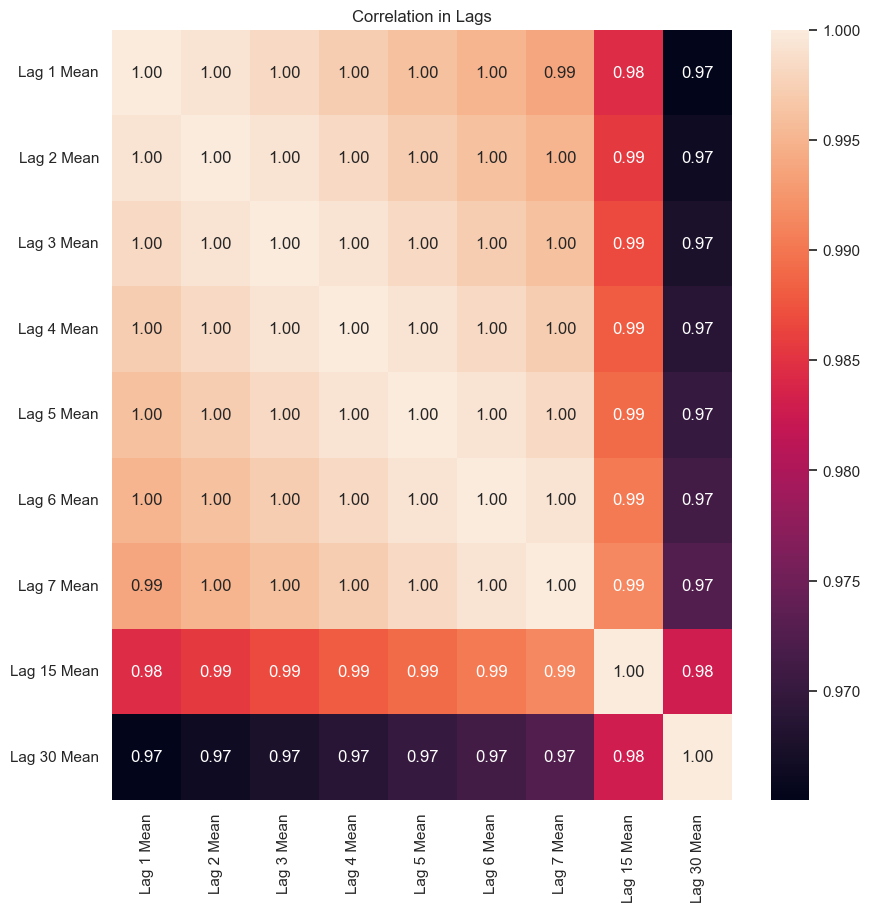

In [62]:
plt.rcParams["figure.figsize"] = (10,10)
lags_data = bitstampUSD.loc[:, bitstampUSD.columns.str.startswith('Lag')]
sns.heatmap(lags_data.corr(), annot=True, fmt=".2f")
plt.title('Correlation in Lags')
plt.show()

In [67]:
def rmse(y_true, y_pred):
    return np.sqrt(np.mean((y_true-y_pred)**2))

def nrmse(y_true, y_pred):
    return -1.0*rmse(y_true, y_pred)

def select_lags(x_train, y_train):

    neg_rmse = make_scorer(nrmse)

    x_train_lags = x_train.loc[:, x_train.columns.str.startswith('Lag')]

    estimator = xgb.XGBRegressor()
    selector = RFECV(estimator, cv=5, scoring = neg_rmse, min_features_to_select=2)
    selector = selector.fit(x_train_lags, y_train)

    features_kept = x_train_lags.columns.values[selector.support_] 
    features_kept = np.concatenate((np.array(x_train.columns[~x_train.columns.str.startswith('Lag')]), features_kept))
    
    return features_kept

## 6. Strategy and PnL Implementation

In [36]:
def strategy(exchanges, model_name):
    models = []
    rmses = []
    rsqs = []
    predictions = pd.DataFrame()
    actuals = pd.DataFrame()
    
    for i in range(0, len(exchanges)):
        print('Running Model', i+1)
        x_train, x_test, y_train, y_test = training_testing_split(0.8, exchanges, i)
        actuals[i] = y_test
        
        if i == 0:
            features_kept = select_lags(x_train, y_train)
            
        x_train = x_train[features_kept]
        x_test = x_test[features_kept]
        
        if model_name == 'XGBoost':
            rmse, rsq, xgb_model, y_pred = xgboost1(x_train, x_test, y_train, y_test)
        elif model_name == 'Random Forest':
            rmse, rsq, xgb_model, y_pred = randomforest1(x_train, x_test, y_train, y_test)
        elif model_name == 'Decision Tree':
            rmse, rsq, xgb_model, y_pred = decisiontree1(x_train, x_test, y_train, y_test)
        elif model_name == 'Bagged Tree':
            rmse, rsq, xgb_model, y_pred = baggedtree1(x_train, x_test, y_train, y_test)
        elif model_name == 'Gradient Boosting':
            rmse, rsq, xgb_model, y_pred = gradientboosting1(x_train, x_test, y_train, y_test)
        elif model_name == 'KNN':
            rmse, rsq, xgb_model, y_pred = knn1(x_train, x_test, y_train, y_test)
        elif model_name == 'Ridge':
            rmse, rsq, xgb_model, y_pred = ridge1(x_train, x_test, y_train, y_test)
        elif model_name == 'Lasso':
            rmse, rsq, xgb_model, y_pred = lasso1(x_train, x_test, y_train, y_test)
        elif model_name == 'Stepwise':
            rmse, rsq, xgb_model, y_pred = stepwise1(x_train, x_test, y_train, y_test)
        predictions[i] = y_pred
        models.append(xgb_model)
        rmses.append(rmse)
        rsqs.append(rsq)
        
    return models, rmses, rsqs, predictions, actuals

In [37]:
def profit_loss(predictions, actuals):
    
    predictions = np.exp(predictions)
    predictions['Min'] = predictions.loc[:, 0:6].min(axis=1)
    predictions['Max'] = predictions.loc[:, 0:6].max(axis=1)
    predictions['PnL'] = predictions['Max'] - predictions['Min']
    predictions['PnL'] = np.where(predictions['PnL'] < 0, 0, predictions['PnL'])
    predictions = predictions.rename(columns={0:'bitstampUSD', 1:'korbitKRW', 2:'btcmarketsAUD', 3:'krakenCAD', \
                                              4:'bcEUR', 5:'bit2cILS', 6:'btcboxJPY'})
    predictions['Bought'] = predictions.iloc[:, 0:6].idxmin(axis=1)
    predictions['Sold'] = predictions.iloc[:, 0:6].idxmax(axis=1)
    
    actuals = actuals.reset_index(drop=True)
    actuals = np.exp(actuals)
    actuals['Bought'] = predictions['Bought']
    actuals['Sold'] = predictions['Sold']
    actuals = actuals.rename(columns={0:'bitstampUSD', 1:'korbitKRW', 2:'btcmarketsAUD', 3:'krakenCAD', \
                                              4:'bcEUR', 5:'bit2cILS', 6:'btcboxJPY'})
    actuals['PnL'] = actuals.lookup(actuals.index, actuals['Sold']) - actuals.lookup(actuals.index, actuals['Bought'])

    return predictions, actuals

In [125]:
all_results_columns= ['Model_Type', 'Data_Splitting_Type', 'RMSE_bitstampUSD', 'RMSE_korbitKRW', 
                      'RMSE_btcmarketsAUD', 'RMSE_krakenCAD', 'RMSE_bcEUR', 'RMSE_bit2cILS', 
                      'RMSE_btcboxJPY', 'Total_RMSE']
all_results= pd.DataFrame(columns= all_results_columns)

## 7. Testing Non-Parametric Models

### XGBoost

In [41]:
def xgboost1(x_train, x_test, y_train, y_test):
    params = {
             'learning_rate' : [0.05, 0.10, 0.15, 0.20, 0.25, 0.30],
             'max_depth' : [3, 4, 5, 6, 8, 10, 12, 15],
             'min_child_weight' : [1, 3, 5, 7],
             'gamma': [0.0, 0.1, 0.2 , 0.3, 0.4],
             'colsample_bytree' : [0.3, 0.4, 0.5 , 0.7]
            }
    xgb1 = xgb.XGBRegressor()
    xgb_random = RandomizedSearchCV(estimator=xgb1, param_distributions=params,\
                                  n_iter=10, cv=3, verbose=0, random_state=42, n_jobs=-1)
    xgb_random.fit(x_train, y_train)
    param = xgb_random.best_params_
    xgb_model = xgb.XGBRegressor(**param)
    xgb_model.fit(x_train, y_train)
    y_pred = xgb_model.predict(x_test)
    rmse = mean_squared_error(np.exp(y_test), np.exp(y_pred), squared=False)
    rsq = r2_score(np.exp(y_test), np.exp(y_pred))
    return rmse, rsq, xgb_model, y_pred

In [42]:
models_xgb, rmses_xgb, rsqs_xgb, predictions_xgb, actuals_xgb = strategy(exchanges, 'XGBoost')

Running Model 1
Running Model 2
Running Model 3
Running Model 4
Running Model 5
Running Model 6
Running Model 7


In [126]:
new_row = pd.Series({'Model_Type': 'XGBOOST', 'Data_Splitting_Type': 'Training_Testing', \
                     'RMSE_bitstampUSD': rmses_xgb[0] , 'RMSE_korbitKRW': rmses_xgb[1], \
                     'RMSE_btcmarketsAUD': rmses_xgb[2], 'RMSE_krakenCAD': rmses_xgb[3], 'RMSE_bcEUR': rmses_xgb[4], \
                     'RMSE_bit2cILS': rmses_xgb[5], 'RMSE_btcboxJPY': rmses_xgb[6], 'Total_RMSE':sum(rmses_xgb)})
all_results = all_results.append(new_row, ignore_index=True)

### Random Forest

In [72]:
def randomforest1(x_train, x_test, y_train, y_test):
    params = {'n_estimators': [40, 50, 60, 70, 80, 90, 100, 110, 120],
               'max_features': [ 'sqrt'],
               'max_depth': [3, 4, 5, 6, 8, 10, 12, 15],
               'min_samples_split': [2, 5, 10],
               'min_samples_leaf': [1, 2, 4],
               'bootstrap': [True, False]}
    rf1 = RandomForestRegressor()
    rf_random = RandomizedSearchCV(estimator=rf1, param_distributions=params,\
                                  n_iter=10, cv=3, verbose=0, random_state=42, n_jobs=-1)
    rf_random.fit(x_train, y_train)
    param = rf_random.best_params_
    rf_model = RandomForestRegressor(**param)
    rf_model.fit(x_train, y_train)
    y_pred = rf_model.predict(x_test)
    rmse = mean_squared_error(np.exp(y_test), np.exp(y_pred), squared=False)
    rsq = r2_score(np.exp(y_test), np.exp(y_pred))
    return rmse, rsq, rf_model, y_pred

In [73]:
models_rf, rmses_rf, rsqs_rf, predictions_rf, actuals_rf = strategy(exchanges, 'Random Forest')

Running Model 1
Running Model 2
Running Model 3
Running Model 4
Running Model 5
Running Model 6
Running Model 7


In [127]:
new_row = pd.Series({'Model_Type': 'Random Forest', 'Data_Splitting_Type': 'Training_Testing', \
                     'RMSE_bitstampUSD': rmses_rf[0] , 'RMSE_korbitKRW': rmses_rf[1], \
                     'RMSE_btcmarketsAUD': rmses_rf[2], 'RMSE_krakenCAD': rmses_rf[3], 'RMSE_bcEUR': rmses_rf[4], \
                     'RMSE_bit2cILS': rmses_rf[5], 'RMSE_btcboxJPY': rmses_rf[6], 'Total_RMSE':sum(rmses_rf)})
all_results = all_results.append(new_row, ignore_index=True)

### Decision Tree

In [75]:
def decisiontree1(x_train, x_test, y_train, y_test):
    params = {'max_depth': [1,3,5,7,9,11,12],
              'min_samples_leaf':[1,2,3,4,5,6,7,8,9,10],
              'max_features':[2,3,4,5]}
    dt1 = DecisionTreeRegressor()
    dt_random = RandomizedSearchCV(estimator=dt1, param_distributions=params,\
                                  n_iter=10, cv=3, verbose=0, random_state=42, n_jobs=-1)
    dt_random.fit(x_train, y_train)
    param = dt_random.best_params_
    dt_model = DecisionTreeRegressor(**param)
    dt_model.fit(x_train, y_train)
    y_pred = dt_model.predict(x_test)
    rmse = mean_squared_error(np.exp(y_test), np.exp(y_pred), squared=False)
    rsq = r2_score(np.exp(y_test), np.exp(y_pred))
    return rmse, rsq, dt_model, y_pred

In [76]:
models_dt, rmses_dt, rsqs_dt, predictions_dt, actuals_dt = strategy(exchanges, 'Decision Tree')

Running Model 1
Running Model 2
Running Model 3
Running Model 4
Running Model 5
Running Model 6
Running Model 7


In [128]:
new_row = pd.Series({'Model_Type': 'Decision Tree ', 'Data_Splitting_Type': 'Training_Testing', \
                     'RMSE_bitstampUSD': rmses_dt[0] , 'RMSE_korbitKRW': rmses_dt[1], 
                     'RMSE_btcmarketsAUD': rmses_dt[2], 'RMSE_krakenCAD': rmses_dt[3], 'RMSE_bcEUR': rmses_dt[4], \
                     'RMSE_bit2cILS': rmses_dt[5], 'RMSE_btcboxJPY': rmses_dt[6], 'Total_RMSE':sum(rmses_dt)})
all_results = all_results.append(new_row, ignore_index=True)

### Bagged Tree

In [78]:
def baggedtree1(x_train, x_test, y_train, y_test):
    params = {'n_estimators' : [40, 50, 60, 70, 80, 90, 100, 110, 120],
              'max_samples' : [0.05, 0.1, 0.2, 0.5],
              'bootstrap' : [True, False],
              'max_features':[2,3,4,5]}
    bt1 = RandomForestRegressor()
    bt_random = RandomizedSearchCV(estimator=bt1, param_distributions=params,\
                                  n_iter=10, cv=3, verbose=0, random_state=42, n_jobs=-1)
    bt_random.fit(x_train, y_train)
    param = bt_random.best_params_
    bt_model = BaggingRegressor(**param)
    bt_model.fit(x_train, y_train)
    y_pred = bt_model.predict(x_test)
    rmse = mean_squared_error(np.exp(y_test), np.exp(y_pred), squared=False)
    rsq = r2_score(np.exp(y_test), np.exp(y_pred))
    return rmse, rsq, bt_model, y_pred

In [79]:
models_bt, rmses_bt, rsqs_bt, predictions_bt, actuals_bt = strategy(exchanges, 'Bagged Tree')

Running Model 1
Running Model 2
Running Model 3
Running Model 4
Running Model 5
Running Model 6
Running Model 7


In [129]:
new_row = pd.Series({'Model_Type': 'Bagged Tree', 'Data_Splitting_Type': 'Training_Testing', \
                     'RMSE_bitstampUSD': rmses_bt[0] , 'RMSE_korbitKRW': rmses_bt[1], 
                     'RMSE_btcmarketsAUD': rmses_bt[2], 'RMSE_krakenCAD': rmses_bt[3], 'RMSE_bcEUR': rmses_bt[4], \
                     'RMSE_bit2cILS': rmses_bt[5], 'RMSE_btcboxJPY': rmses_bt[6], 'Total_RMSE':sum(rmses_bt)})
all_results = all_results.append(new_row, ignore_index=True)

### Gradient Boosting

In [81]:
def gradientboosting1(x_train, x_test, y_train, y_test):
    params = {'learning_rate': [0.05, 0.10, 0.15, 0.20, 0.25, 0.30],
              'n_estimators' : [40, 50, 60, 70, 80, 90, 100, 110, 120],
              'max_depth'    : [3, 4, 5, 6, 8, 10, 12, 15]}
    gbr1 = GradientBoostingRegressor()
    gbr_random = RandomizedSearchCV(estimator=gbr1, param_distributions=params,\
                                  n_iter=10, cv=3, verbose=0, random_state=42, n_jobs=-1)
    gbr_random.fit(x_train, y_train)
    param = gbr_random.best_params_
    gbr_model = GradientBoostingRegressor(**param)
    gbr_model.fit(x_train, y_train)
    y_pred = gbr_model.predict(x_test)
    rmse = mean_squared_error(np.exp(y_test), np.exp(y_pred), squared=False)
    rsq = r2_score(np.exp(y_test), np.exp(y_pred))
    return rmse, rsq, gbr_model, y_pred

In [82]:
models_gbr, rmses_gbr, rsqs_gbr, predictions_gbr, actuals_gbr = strategy(exchanges, 'Gradient Boosting')

Running Model 1
Running Model 2
Running Model 3
Running Model 4
Running Model 5
Running Model 6
Running Model 7


In [130]:
new_row = pd.Series({'Model_Type': 'Gradient Boosting', 'Data_Splitting_Type': 'Training_Testing', \
                     'RMSE_bitstampUSD': rmses_gbr[0] , 'RMSE_korbitKRW': rmses_gbr[1], 
                     'RMSE_btcmarketsAUD': rmses_gbr[2], 'RMSE_krakenCAD': rmses_gbr[3], 'RMSE_bcEUR': rmses_gbr[4], \
                     'RMSE_bit2cILS': rmses_gbr[5], 'RMSE_btcboxJPY': rmses_gbr[6], 'Total_RMSE':sum(rmses_gbr)})
all_results = all_results.append(new_row, ignore_index=True)

### KNN

In [84]:
# def knn1(x_train, x_test, y_train, y_test):
#     params = {'n_neighbors': [30, 60, 100]}
#     knn1 = KNeighborsRegressor()
#     knn_random = RandomizedSearchCV(estimator=knn1, param_distributions=params,\
#                                   n_iter=10, cv=3, verbose=0, random_state=42, n_jobs=-1)
#     knn_random.fit(x_train, y_train)
#     param = knn_random.best_params_
#     knn_model = KNeighborsRegressor(**param)
#     knn_model.fit(x_train, y_train)
#     y_pred = knn_model.predict(x_test)
#     rmse = mean_squared_error(np.exp(y_test), np.exp(y_pred), squared=False)
#     rsq = r2_score(np.exp(y_test), np.exp(y_pred))
#     return rmse, rsq, knn_model, y_pred

In [85]:
# models_knn, rmses_knn, rsqs_knn, predictions_knn, actuals_knn = strategy(exchanges, 'KNN')

In [86]:
# new_row = pd.Series({'Model_Type': 'KNN', 'Data_Splitting_Type': 'Training_Testing', \
#                      'RMSE_bitstampUSD': rmses_knn[0] , 'RMSE_korbitKRW': rmses_knn[1], 
#                     'RMSE_btcmarketsAUD': rmses_knn[2], 'RMSE_krakenCAD': rmses_knn[3], 'RMSE_bcEUR': rmses_knn[4],\
#                      'RMSE_bit2cILS': rmses_knn[5], 'RMSE_btcboxJPY': rmses_knn[6], 'Total_RMSE':sum(rmses_knn)})
# all_results = all_results.append(new_row, ignore_index=True)

### Neural Network

In [87]:
"""
Since tensorflow could not be executed on Mac, a separate computer was used.
While the code was replicated, the results were manually added.
"""

'\nSince tensorflow could not be executed on Mac, a separate computer was used.\nWhile the code was replicated, the results were manually added.\n'

In [ ]:
def hyper_parameter_optimisation():
    batch_size=[8, 16, 32, 64]
    dense_units= [8, 16, 32, 64]
    epochs= [10, 20, 30, 40]
    
    batch_size_list=[]
    dense_units_list=[]
    epochs_list=[]
    rmse_list=[]
    
    X_train, X_test, y_train, y_test = training_testing_split(0.8, exchanges, 0)
    
    for i in range(0, len(batch_size_list)):
        for j in range(0, len(dense_units_list)):
            for k in range(0, len(accuracy_units_list)):
                model = Sequential()
                model.add(Dense(units= dense_units_list[j], activation='relu', input_dim=X_train.shape[1]))
                model.add(Dropout(0.2))
                model.add(Dense(units= dense_units_list[j], activation='relu'))
                model.add(Dropout(0.2))
                model.add(Dense(units=1))
                model.compile(optimizer='adam', loss='mse', metrics=['mae'])
                model.fit(X_train, y_train, epochs=epochs_list[k], batch_size= batch_size_list[i], validation_data=(X_test, y_test))
                y_pred = model.predict(X_test)
                mse = mean_squared_error(y_test, y_pred, squared=False)
                print(f"Test MSE: {mse}")
                rmse_list.append(mse)
                batch_size_list.append(batch_size_list[i])
                dense_units_list.append(dense_units_list[j])
                epochs_list.append(epochs)
    
    
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    ax.scatter(batch_size_list, dense_units_list, epochs_list, c=rmse_list)

    ax.set_xlabel('Batch Size')
    ax.set_ylabel('Dense Units')
    ax.set_zlabel('Epochs')

    plt.show()

<img src="dl.png" width="500" height="340">

In [ ]:
def deep_learning_strategy(exchanges, parameters):
    
    rmse_list=[]
    models=[]
    for i in range(0, len(exchanges)):
        print('Running Model', i+1)
        X_train, X_test, y_train, y_test = training_testing_split(0.8, exchanges, i)
        model = Sequential()
        model.add(Dense(units=64, activation='relu', input_dim=X_train.shape[1]))
        model.add(Dropout(0.2))
        model.add(Dense(units=64, activation='relu'))
        model.add(Dropout(0.2))
        model.add(Dense(units=1))
        model.compile(optimizer='adam', loss='mse', metrics=['mae'])
        model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_test, y_test))
        y_pred = model.predict(X_test)
        mse = mean_squared_error(y_test, y_pred, squared=False)
        print(f"Test MSE: {mse}")
        rmse_list.append(mse)
        models.append(model)
    return rmse_list, models

models_sdl, rmses_sdl = deep_learning_strategy(exchanges, parameters)

In [121]:
rmses_sdl=[2655.159103, 2892.113178, 9065.818177, 1265.3828898, 6280.891692, 1941.641257, 7666.278487]

In [131]:
new_row = pd.Series({'Model_Type': 'Sequential-Deep Learning', 'Data_Splitting_Type': 'Training_Testing', \
                     'RMSE_bitstampUSD': rmses_sdl[0] , 'RMSE_korbitKRW': rmses_sdl[1], \
                     'RMSE_btcmarketsAUD': rmses_sdl[2], 'RMSE_krakenCAD': rmses_sdl[3], 'RMSE_bcEUR': rmses_sdl[4], \
                     'RMSE_bit2cILS': rmses_sdl[5], 'RMSE_btcboxJPY': rmses_sdl[6], 'Total_RMSE':sum(rmses_sdl)})
all_results = all_results.append(new_row, ignore_index=True)

## 8. Testing Parametric Models

### Forward Stepwise OLS

In [97]:
def stepwise1(x_train, x_test, y_train, y_test):
    linear = LinearRegression()
    sfs=SequentialFeatureSelector(estimator = linear,
                                  n_features_to_select=10, 
                                  direction = 'forward',
                                  cv = 3,
                                  scoring = 'r2')
    sfs.fit(x_train, y_train)
    sfs_df = pd.DataFrame(columns = ['Feature', 'SFS_filter'])
    sfs_df['Feature'] = x_train.columns
    sfs_df['SFS_filter'] = sfs.get_support().tolist()
    sfs_df_v2 = sfs_df[sfs_df['SFS_filter']==True]
    sfs_top_features = sfs_df_v2['Feature'].tolist()
    
    x_train= x_train[sfs_top_features]
    x_test = x_test[sfs_top_features]
    linear2 = LinearRegression().fit(x_train, y_train)
    
    y_pred = linear2.predict(x_test)
    rmse = mean_squared_error(np.exp(y_test), np.exp(y_pred), squared=False)
    rsq = r2_score(np.exp(y_test), np.exp(y_pred))
    return rmse, rsq, linear2, y_pred

In [98]:
models_rols, rmses_rols, rsqs_rols, predictions_rols, actuals_rols = strategy(exchanges, 'Stepwise')

Running Model 1
Running Model 2
Running Model 3
Running Model 4
Running Model 5
Running Model 6
Running Model 7


In [132]:
new_row = pd.Series({'Model_Type': 'Forward Stepwise OLS', 'Data_Splitting_Type': 'Training_Testing', \
                     'RMSE_bitstampUSD': rmses_rols[0] , 'RMSE_korbitKRW': rmses_rols[1], 
            'RMSE_btcmarketsAUD': rmses_rols[2], 'RMSE_krakenCAD': rmses_rols[3], 'RMSE_bcEUR': rmses_rols[4], \
                    'RMSE_bit2cILS': rmses_rols[5], 'RMSE_btcboxJPY': rmses_rols[6], 'Total_RMSE':sum(rmses_rols)})
all_results = all_results.append(new_row, ignore_index=True)

### Ridge

In [101]:
def ridge1(x_train, x_test, y_train, y_test):
    params = {'alpha': [0.1, 0.5, 1, 2, 5, 10],
              'fit_intercept': [True, False],
              'solver': ['svd', 'lsqr']}

    ridge = Ridge()
    ridge_random = RandomizedSearchCV(estimator=ridge, param_distributions=params, \
                                      n_iter=10, cv=3, verbose=0, random_state=42, n_jobs=-1)
    ridge_random.fit(x_train, y_train)
    param = ridge_random.best_params_
    ridge_model = Ridge(**param)
    ridge_model.fit(x_train, y_train)
    y_pred = ridge_model.predict(x_test)
    rmse = mean_squared_error(np.exp(y_test), np.exp(y_pred), squared=False)
    rsq = r2_score(np.exp(y_test), np.exp(y_pred))
    return rmse, rsq, ridge_model, y_pred

In [102]:
models_ridge, rmses_ridge, rsqs_ridge, predictions_ridge, actuals_ridge = strategy(exchanges, 'Ridge')

Running Model 1
Running Model 2
Running Model 3
Running Model 4
Running Model 5
Running Model 6
Running Model 7


In [133]:
new_row = pd.Series({'Model_Type': 'Ridge', 'Data_Splitting_Type': 'Training_Testing', \
                     'RMSE_bitstampUSD': rmses_ridge[0] , 'RMSE_korbitKRW': rmses_ridge[1], 
            'RMSE_btcmarketsAUD': rmses_ridge[2], 'RMSE_krakenCAD': rmses_ridge[3], 'RMSE_bcEUR': rmses_ridge[4], \
                    'RMSE_bit2cILS': rmses_ridge[5], 'RMSE_btcboxJPY': rmses_ridge[6], 'Total_RMSE':sum(rmses_ridge)})
all_results = all_results.append(new_row, ignore_index=True)

### Lasso

In [104]:
def lasso1(x_train, x_test, y_train, y_test):
    params = {'alpha': [0.1, 0.5, 1, 2, 5, 10],
        'fit_intercept': [True, False],
        'precompute': [True, False],
        'selection': ['cyclic', 'random'],
        'max_iter': [10000]}

    lasso = Lasso()
    lasso_random = RandomizedSearchCV(estimator=lasso, param_distributions=params, \
                                      n_iter=100, cv=3, verbose=0, random_state=42, n_jobs=-1)
    lasso_random.fit(x_train, y_train)
    param = lasso_random.best_params_
    lasso_model = Lasso(**param)
    lasso_model.fit(x_train, y_train)
    y_pred = lasso_model.predict(x_test)
    rmse = mean_squared_error(np.exp(y_test), np.exp(y_pred), squared=False)
    rsq = r2_score(np.exp(y_test), np.exp(y_pred))
    return rmse, rsq, lasso_model, y_pred

In [105]:
models_lasso, rmses_lasso, rsqs_lasso, predictions_lasso, actuals_lasso = strategy(exchanges, 'Lasso')

Running Model 1
Running Model 2
Running Model 3
Running Model 4
Running Model 5
Running Model 6
Running Model 7


In [134]:
new_row = pd.Series({'Model_Type': 'Lasso', 'Data_Splitting_Type': 'Training_Testing', \
                     'RMSE_bitstampUSD': rmses_lasso[0] , 'RMSE_korbitKRW': rmses_lasso[1], 
            'RMSE_btcmarketsAUD': rmses_lasso[2], 'RMSE_krakenCAD': rmses_lasso[3], 'RMSE_bcEUR': rmses_lasso[4], \
                    'RMSE_bit2cILS': rmses_lasso[5], 'RMSE_btcboxJPY': rmses_lasso[6], 'Total_RMSE':sum(rmses_lasso)})
all_results = all_results.append(new_row, ignore_index=True)

## 9. Testing Time Series Models

In [51]:
def time_series_arima(exchanges):
    preds_list=[]
    conf_int_list=[]
    
    for i in range(0, len(exchanges)):
        print('Running Model', i+1)
        x_train, x_test, y_train, y_test= training_testing_split(0.1, exchanges, i)
        model = auto_arima(y_train, X=x_train, seasonal=True, m=6, trace=True)
        preds, conf_int = model.predict(X=x_test, n_periods=len(y_test), return_conf_int=True)
        preds_list.append(preds)
        conf_int_list.append(conf_int)
    return preds_list, conf_int_list

preds_list, conf_int_list  = time_series_arima(exchanges)     

Running Model 1
Performing stepwise search to minimize aic
 ARIMA(2,0,2)(1,0,1)[6] intercept   : AIC=-25496.968, Time=11.79 sec
 ARIMA(0,0,0)(0,0,0)[6] intercept   : AIC=-15694.464, Time=3.50 sec
 ARIMA(1,0,0)(1,0,0)[6] intercept   : AIC=-25384.029, Time=8.54 sec
 ARIMA(0,0,1)(0,0,1)[6] intercept   : AIC=-21072.442, Time=9.78 sec
 ARIMA(0,0,0)(0,0,0)[6]             : AIC=-15696.452, Time=3.13 sec
 ARIMA(2,0,2)(0,0,1)[6] intercept   : AIC=-25383.927, Time=11.29 sec
 ARIMA(2,0,2)(1,0,0)[6] intercept   : AIC=-25129.054, Time=10.58 sec
 ARIMA(2,0,2)(2,0,1)[6] intercept   : AIC=-25441.996, Time=18.69 sec
 ARIMA(2,0,2)(1,0,2)[6] intercept   : AIC=-25525.804, Time=24.80 sec
 ARIMA(2,0,2)(0,0,2)[6] intercept   : AIC=-25574.414, Time=21.26 sec
 ARIMA(1,0,2)(0,0,2)[6] intercept   : AIC=-25509.405, Time=19.81 sec
 ARIMA(2,0,1)(0,0,2)[6] intercept   : AIC=-25772.590, Time=19.41 sec
 ARIMA(2,0,1)(0,0,1)[6] intercept   : AIC=-25385.415, Time=8.93 sec
 ARIMA(2,0,1)(1,0,2)[6] intercept   : AIC=-25469.

 ARIMA(2,0,3)(2,0,1)[6] intercept   : AIC=-23708.769, Time=20.83 sec
 ARIMA(1,0,3)(1,0,0)[6] intercept   : AIC=-23649.037, Time=10.02 sec
 ARIMA(3,0,3)(1,0,0)[6] intercept   : AIC=-23381.108, Time=20.27 sec
 ARIMA(2,0,4)(1,0,0)[6] intercept   : AIC=-22758.810, Time=11.59 sec
 ARIMA(1,0,2)(1,0,0)[6] intercept   : AIC=-23278.639, Time=8.85 sec
 ARIMA(1,0,4)(1,0,0)[6] intercept   : AIC=-23492.980, Time=9.60 sec
 ARIMA(3,0,2)(1,0,0)[6] intercept   : AIC=-23247.569, Time=14.47 sec
 ARIMA(3,0,4)(1,0,0)[6] intercept   : AIC=-22817.741, Time=16.56 sec
 ARIMA(2,0,3)(1,0,0)[6]             : AIC=-23392.468, Time=9.12 sec

Best model:  ARIMA(2,0,3)(1,0,0)[6] intercept
Total fit time: 467.469 seconds
Running Model 5
Performing stepwise search to minimize aic
 ARIMA(2,0,2)(1,0,1)[6] intercept   : AIC=-20277.744, Time=11.87 sec
 ARIMA(0,0,0)(0,0,0)[6] intercept   : AIC=-14919.138, Time=1.13 sec
 ARIMA(1,0,0)(1,0,0)[6] intercept   : AIC=-20793.235, Time=8.00 sec
 ARIMA(0,0,1)(0,0,1)[6] intercept   : A

In [141]:
rmses_ts=[]
for i in range(0, len(exchanges)):
    x_train, x_test, y_train, y_test= training_testing_split(0.1, exchanges, i)
    rmse = mean_squared_error(np.exp(y_test), np.exp(preds_list[i]), squared=False)
    rmses_ts.append(rmse)
    

In [143]:
new_row = pd.Series({'Model_Type': 'Time Series', 'Data_Splitting_Type': 'Training_Testing', \
                     'RMSE_bitstampUSD': rmses_ts[0] , 'RMSE_korbitKRW': rmses_ts[1], 
            'RMSE_btcmarketsAUD': rmses_ts[2], 'RMSE_krakenCAD': rmses_ts[3], 'RMSE_bcEUR': rmses_ts[4], \
                    'RMSE_bit2cILS': rmses_ts[5], 'RMSE_btcboxJPY': rmses_ts[6], 'Total_RMSE':sum(rmses_ts)})
all_results = all_results.append(new_row, ignore_index=True)

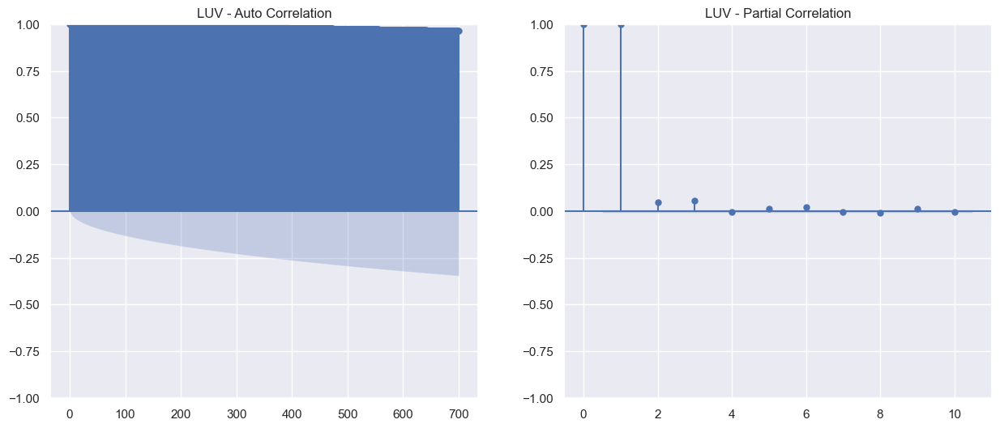

In [110]:
fig, ax = plt.subplots(1, 2, figsize=(15,6))

plot_acf(bitstampUSD['price'], lags= 700, ax=ax[0], title='LUV - Auto Correlation')
plot_pacf(bitstampUSD['price'], lags= 10, ax=ax[1], title='LUV - Partial Correlation')

plt.show()

## 10. Results: Best Model
For the best model we can show various graphs

In [156]:
all_results = all_results.drop('Data_Splitting_Type', axis=1)
display(all_results)

,Model_Type,RMSE_bitstampUSD,RMSE_korbitKRW,RMSE_btcmarketsAUD,RMSE_krakenCAD,RMSE_bcEUR,RMSE_bit2cILS,RMSE_btcboxJPY,Total_RMSE
0,XGBOOST,1604.865754,1426.071271,1786.878828,1666.353047,1981.822197,1789.696391,1486.713305,11742.400792
1,Random Forest,3945.352825,4992.313033,4427.159617,3807.133711,4596.305898,6056.154328,3861.135924,31685.555335
2,Decision Tree,7532.495712,2938.281966,3373.342206,2569.060561,2947.764434,3981.456032,2244.305102,25586.706013
3,Bagged Tree,4211.883173,5644.254359,3763.147719,4250.077676,4638.628050,4393.146483,4068.454734,30969.592195
4,Gradient Boosting,1509.835039,1473.774466,1826.603708,2060.705056,2168.421471,2140.762616,1871.618872,13051.721228
5,Sequential-Deep Learning,2655.159103,2892.113178,9065.818177,1265.382890,6280.891692,1941.641257,7666.278487,31767.284784
6,Forward Stepwise OLS,885.327897,802.418740,837.890389,868.454366,897.651295,930.532256,909.777319,6132.052263
7,Ridge,900.782361,810.918567,858.820757,883.118540,909.219480,940.901735,906.731371,6210.492810
8,Lasso,934.313015,857.876574,892.918630,919.707873,954.719246,964.685943,936.026162,6460.247441
9,Time Series,2107.992184,4390.354114,2233.475439,2839.807533,1824.338388,2927.971504,3220.603678,19544.542840


In [ ]:
predictions_stepwise, actuals_stepwise = profit_loss(predictions_rols, actuals_rols)
predictions_xgb, actuals_xgb = profit_loss(predictions_xgb, actuals_xgb)
predictions_rf, actuals_rf = profit_loss(predictions_rf, actuals_rf)
predictions_dt, actuals_dt = profit_loss(predictions_dt, actuals_dt)
predictions_bt, actuals_bt = profit_loss(predictions_bt, actuals_bt)
predictions_gbr, actuals_gbr = profit_loss(predictions_gbr, actuals_gbr)
predictions_ridge, actuals_ridge = profit_loss(predictions_ridge, actuals_ridge)
predictions_lasso, actuals_lasso = profit_loss(predictions_lasso, actuals_lasso)

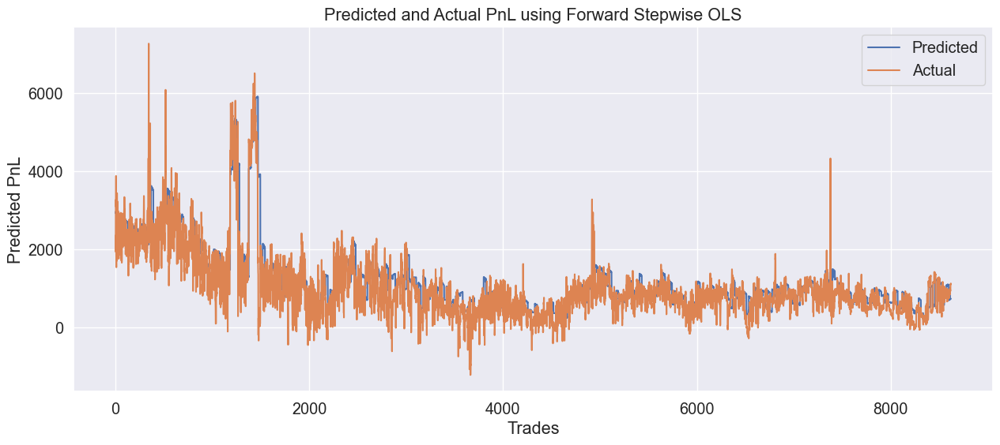

In [113]:
plt.rcParams["figure.figsize"] = (15,6)
sns.set(font_scale=1.3) 

plt.xlabel('Trades')
plt.ylabel('Predicted PnL')
plt.title('Predicted and Actual PnL using Forward Stepwise OLS')

plt.plot(predictions_stepwise['PnL'], label='Predicted')
plt.plot(actuals_stepwise['PnL'], label='Actual')

plt.legend()
plt.show()

In [115]:
combined_pnl = pd.DataFrame()

combined_pnl['Actual'] = actuals_stepwise['PnL'].cumsum()
combined_pnl['XGBoost'] = predictions_xgb['PnL'].cumsum()
combined_pnl['Random Forest'] = predictions_rf['PnL'].cumsum()
combined_pnl['Decision Tree'] = predictions_dt['PnL'].cumsum()
combined_pnl['Bagged Tree'] = predictions_bt['PnL'].cumsum()
combined_pnl['Gradient Boosting'] = predictions_gbr['PnL'].cumsum()

combined_pnl['Forward Stepwise OLS'] = predictions_stepwise['PnL'].cumsum()
combined_pnl['Ridge'] = predictions_ridge['PnL'].cumsum()
combined_pnl['Lasso'] = predictions_lasso['PnL'].cumsum()

combined_pnl = combined_pnl.reset_index()

In [157]:
predictions_ts = pd.DataFrame()
for i in range(0, len(preds_list)):
    predictions_ts[i] = preds_list[i][30171:]

In [149]:
predictions_ts, actuals_ts = profit_loss(predictions_rols, actuals_rols)
combined_pnl['ARIMA'] = predictions_ts['PnL'].cumsum()

In [164]:
fig = px.line(combined_pnl,
             x='index',
             y=['Actual', 'XGBoost', 'Random Forest', 'Decision Tree', \
                'Bagged Tree', 'Gradient Boosting'],
             render_mode="SVG")

fig.update_layout(
    width       = 950,
    height      = 500,
    title       = dict(text='<b>Actual vs Predicted Cumulative PnL (Non-Parametric)</b>', font=dict(size=25), x=0.5),
    yaxis_title = dict(text='PnL (USD)', font=dict(size=13)),
    xaxis_title = dict(text='Trades', font=dict(size=13)),
    margin      = dict(l=0, r=20, t=55, b=20),
    legend_title = 'Model',
    legend=dict(orientation="h", x=0, xanchor='left', y=-0.3, yanchor='bottom')
)
fig.show(config={'displayModeBar': False})

In [165]:
fig = px.line(combined_pnl,
             x='index',
             y=['Actual', 'Forward Stepwise OLS', 'Ridge', 'Lasso'],
             render_mode="SVG")

fig.update_layout(
    width       = 950,
    height      = 500,
    title       = dict(text='<b>Actual vs Predicted Cumulative PnL (Parametric)</b>', \
                       font=dict(size=25), x=0.5),
    yaxis_title = dict(text='PnL (USD)', font=dict(size=13)),
    xaxis_title = dict(text='Trades', font=dict(size=13)),
    margin      = dict(l=0, r=20, t=55, b=20),
    legend_title = 'Model',
    legend=dict(orientation="h", x=0, xanchor='left', y=-0.3, yanchor='bottom')
)
fig.show(config={'displayModeBar': False})

In [166]:
fig = px.line(combined_pnl,
             x='index',
             y=['Actual', 'ARIMA'],
             render_mode="SVG")

fig.update_layout(
    width       = 950,
    height      = 500,
    title       = dict(text='<b>Actual vs Predicted Cumulative PnL (Time Series)</b>', \
                       font=dict(size=25), x=0.5),
    yaxis_title = dict(text='PnL (USD)', font=dict(size=13)),
    xaxis_title = dict(text='Trades', font=dict(size=13)),
    margin      = dict(l=0, r=20, t=55, b=20),
    legend_title = 'Model',
    legend=dict(orientation="h", x=0, xanchor='left', y=-0.2, yanchor='bottom')
)
fig.show(config={'displayModeBar': False})

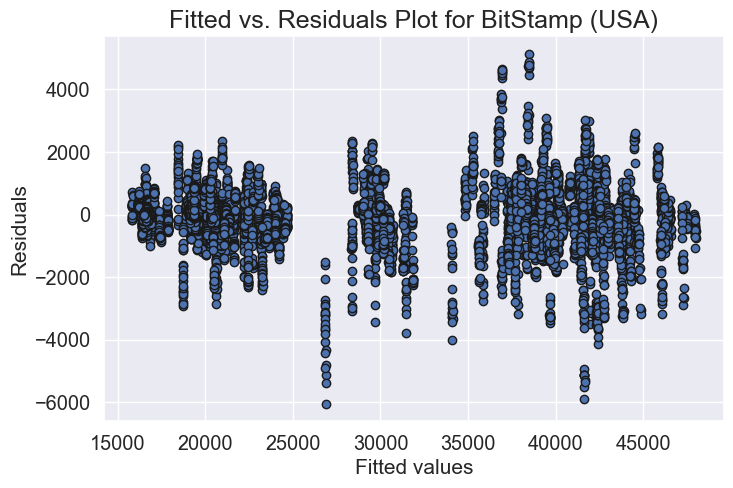

In [118]:
plt.figure(figsize=(8,5))
p=plt.scatter(x=predictions_stepwise['bitstampUSD'],y=actuals_stepwise['bitstampUSD']-\
              predictions_stepwise['bitstampUSD'],edgecolor='k')
plt.xlabel("Fitted values",fontsize=15)
plt.ylabel("Residuals",fontsize=15)
plt.title("Fitted vs. Residuals Plot for BitStamp (USA)",fontsize=18)
plt.grid(True)
plt.show()

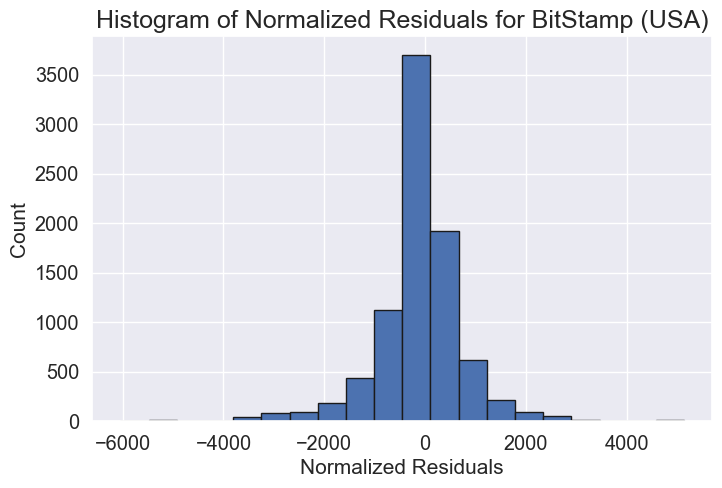

In [119]:
plt.figure(figsize=(8,5))
plt.hist(actuals_stepwise['bitstampUSD']-predictions_stepwise['bitstampUSD'],bins=20,edgecolor='k')
plt.ylabel('Count',fontsize=15)
plt.xlabel('Normalized Residuals',fontsize=15)
plt.title("Histogram of Normalized Residuals for BitStamp (USA)",fontsize=18)
plt.show()

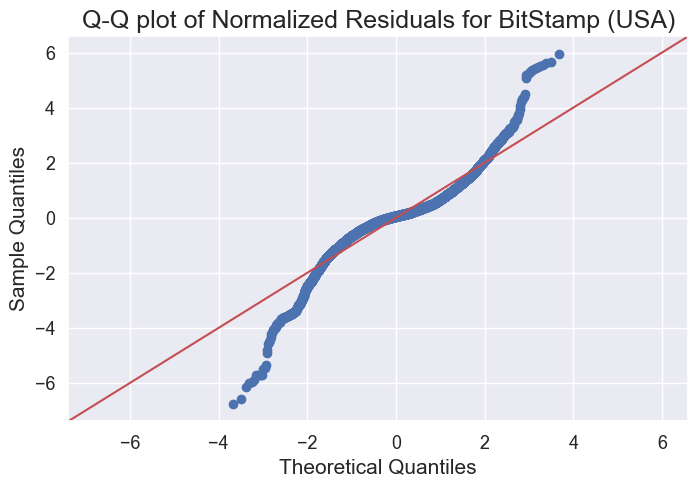

In [120]:
plt.rcParams["figure.figsize"] = (8,5)
qqplot(actuals_stepwise['bitstampUSD']-predictions_stepwise['bitstampUSD'],line='45',fit='True')
plt.xticks(fontsize=13)
plt.yticks(fontsize=13)
plt.xlabel("Theoretical Quantiles",fontsize=15)
plt.ylabel("Sample Quantiles",fontsize=15)
plt.title("Q-Q plot of Normalized Residuals for BitStamp (USA)",fontsize=18)
plt.show()

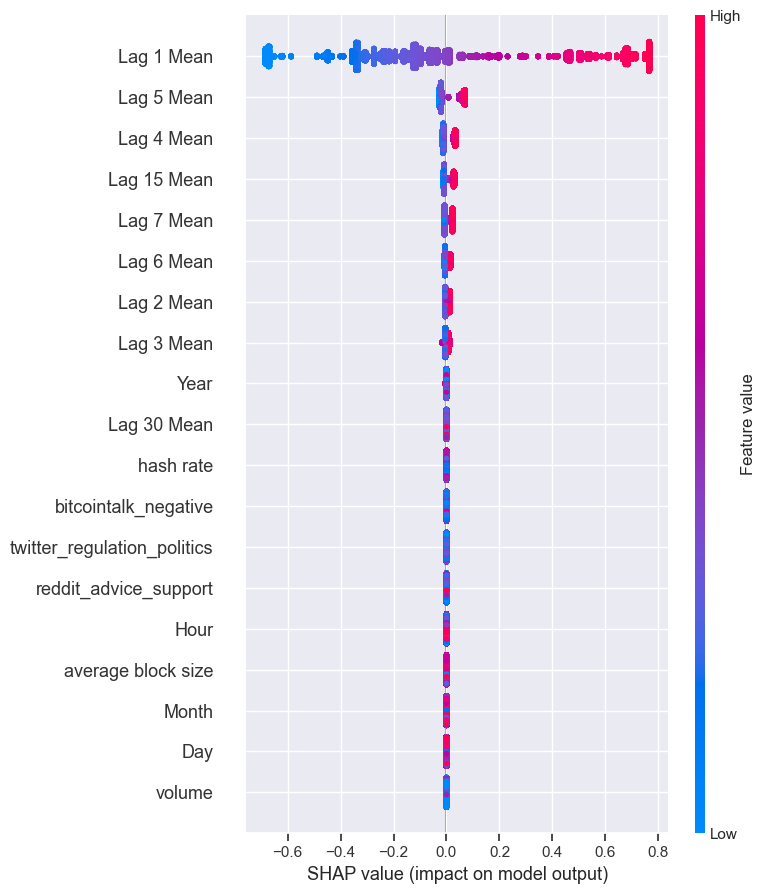

In [45]:
def shap_explainability(X, y):
    model = xgboost.train({"learning_rate": 0.01}, xgboost.DMatrix(X, label=y), 100)
    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(X)
    shap.summary_plot(shap_values, X) 

X_train, X_test, y_train, y_test = training_testing_split(0.8, exchanges, 0)    
shap_explainability(X_train, y_train)